In [1]:
import pandas as pd

In [2]:
import pandas as pd

# The file appears to be space/whitespace separated
# Using delimiter=r'\s+' to handle multiple spaces/tabs
info = pd.read_csv('info.txt', delimiter=r'\s+')

# Filter columns: keep 'runid' and columns starting with 'ocn.' but exclude 'ocean_fw'
ocn_columns = [col for col in info.columns if col.startswith('ocn.')]
columns_to_keep = ['runid'] + ocn_columns

# Remove 'ocean_fw' if it exists in the selected columns
if 'ocn.l_noise_fw' in columns_to_keep:
    columns_to_keep.remove('ocn.l_noise_fw')

# Select only the desired columns
params = info[columns_to_keep]

# Display the results
print("Original shape:", info.shape)
print("Filtered shape:", params.shape)
print("\nKept columns:")
print(params.columns.tolist())
print("\nFirst 5 rows of filtered data:")
print(params.head())

Original shape: (99, 8)
Filtered shape: (99, 7)

Kept columns:
['runid', 'ocn.diff_dia_min', 'ocn.drag_topo_fac', 'ocn.slope_max', 'ocn.diff_iso', 'ocn.diff_gm', 'ocn.diff_dia_max']

First 5 rows of filtered data:
   runid  ocn.diff_dia_min  ocn.drag_topo_fac  ocn.slope_max  ocn.diff_iso  \
0      1          0.000010           2.816063       0.001247   1615.606127   
1      2          0.000010           2.760967       0.000817   1440.298245   
2      3          0.000011           2.553815       0.001108   1648.789119   
3      4          0.000010           3.425434       0.000784   1373.056807   
4      5          0.000011           2.281333       0.001231   1309.914618   

   ocn.diff_gm  ocn.diff_dia_max  
0  1178.446903          0.000139  
1  1156.620678          0.000179  
2  1727.339243          0.000151  
3  1172.548331          0.000140  
4  1594.469916          0.000136  


In [3]:
# Basic descriptive statistics
print("\nDescriptive Statistics:")
print(params.describe())


Descriptive Statistics:
           runid  ocn.diff_dia_min  ocn.drag_topo_fac  ocn.slope_max  \
count  99.000000         99.000000          99.000000      99.000000   
mean   50.000000          0.000010           2.997310       0.001000   
std    28.722813          0.000001           0.436868       0.000146   
min     1.000000          0.000008           2.264693       0.000751   
25%    25.500000          0.000009           2.625165       0.000875   
50%    50.000000          0.000010           2.988873       0.000998   
75%    74.500000          0.000011           3.376068       0.001124   
max    99.000000          0.000012           3.749145       0.001247   

       ocn.diff_iso  ocn.diff_gm  ocn.diff_dia_max  
count     99.000000    99.000000         99.000000  
mean    1497.397723  1500.157923          0.000150  
std      216.836888   219.136266          0.000022  
min     1130.438668  1126.433930          0.000113  
25%     1312.015546  1313.820452          0.000132  
50%     

Found 99 files
Default run loaded successfully


Text(0.5, 0, 'Model Time')

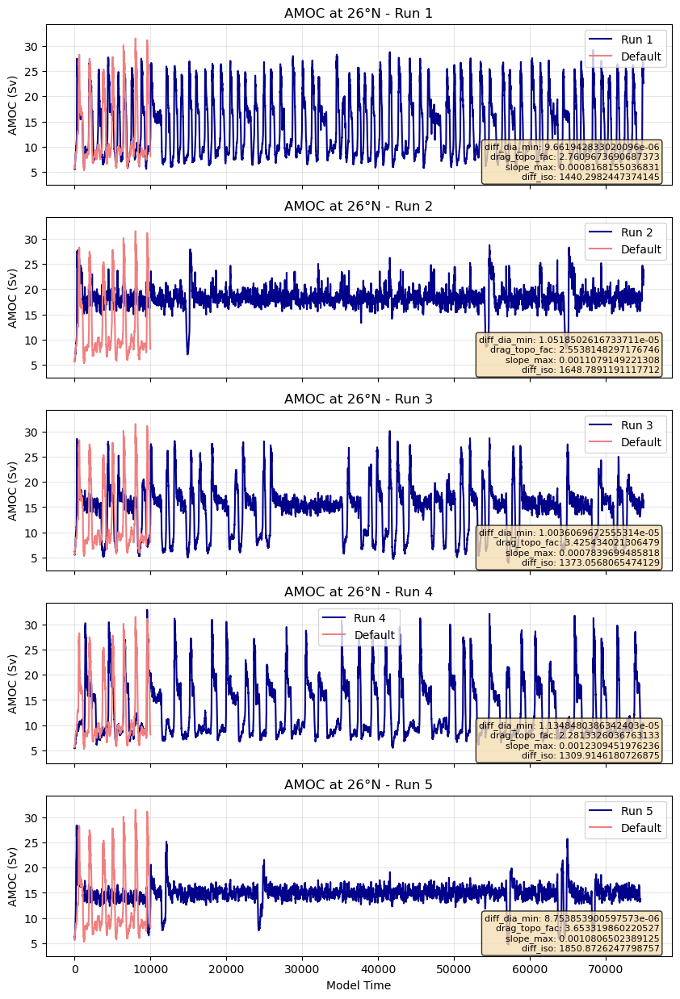

In [4]:
import xarray as xr
import matplotlib.pyplot as plt
import os

# Find all ocn_ts.nc files
model_files = []
run_labels = []

for run_id in range(100):
    file_path = f"{run_id}/ocn_ts.nc"
    if os.path.exists(file_path):
        model_files.append(file_path)
        run_labels.append(str(run_id))

print(f"Found {len(model_files)} files")
files = model_files[:5]
labels = run_labels[:5]

# Create subplots
fig, axes = plt.subplots(len(files), 1, figsize=(10, 3*len(files)), 
                        sharex=True, sharey=True)

# Handle case where there's only one file
if len(model_files) == 1:
    axes = [axes]

# Load default run
default_file = "../test_PPE/default/ocn_ts.nc"
if os.path.exists(default_file):
    ds_default = xr.open_dataset(default_file)
    print("Default run loaded successfully")
else:
    ds_default = None
    print("Warning: Default run not found")

# Plot each run
for i, (file, label) in enumerate(zip(files, labels)):
    ds = xr.open_dataset(file)
    
    # Plot the run in dark blue
    ds.amoc26N.plot(ax=axes[i], x='time', linewidth=1.5, color='darkblue', label=f'Run {label}')
    
    # Plot default run in pale red if available
    if ds_default is not None:
        ds_default.amoc26N.plot(ax=axes[i], x='time', linewidth=1.5, color='lightcoral', label='Default')
    
    axes[i].set_title(f'AMOC at 26°N - Run {label}')
    axes[i].set_ylabel('AMOC (Sv)')
    axes[i].grid(True, alpha=0.3)
    axes[i].legend()
    
    # Add parameter values as text on the plot
    run_id = int(label)
    if run_id < len(params):
        param_row = params.iloc[run_id]
        param_text = (f"diff_dia_min: {param_row['ocn.diff_dia_min']}\n"
                     f"drag_topo_fac: {param_row['ocn.drag_topo_fac']}\n"
                     f"slope_max: {param_row['ocn.slope_max']}\n"
                     f"diff_iso: {param_row['ocn.diff_iso']}")
        axes[i].text(0.98, 0.02, param_text, transform=axes[i].transAxes, 
                    verticalalignment='bottom', horizontalalignment='right', fontsize=8, 
                    bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))
    
    # Remove x-label for all but the bottom plot
    if i < len(model_files) - 1:
        axes[i].set_xlabel('')
    
    ds.close()

# Close default dataset
if ds_default is not None:
    ds_default.close()

# Set x-label only on bottom plot
axes[-1].set_xlabel('Model Time')
#plt.tight_layout()
#plt.show()

In [5]:
import numpy as np
from scipy.stats import gaussian_kde
from scipy.signal import welch

def compute_summary_stats(amoc_data, time_data, threshold=None, grid_points=100,
                          smooth_win=20, psd_bins_count=10, quantiles=[0.1, 0.5, 0.9],
                          remove_spinup=True, spinup_fraction=0.0):
    
    amoc_data = np.asarray(amoc_data)
    time_data = np.asarray(time_data)
    
    # Remove spinup if requested
    if remove_spinup:
        start_idx = int(len(amoc_data) * spinup_fraction)
        amoc_data = amoc_data[start_idx:]
        time_data = time_data[start_idx:]
        # Reset time origin
        time_data = time_data - time_data[0]
    amoc_data = np.asarray(amoc_data)
    time_data = np.asarray(time_data)
    
    # ----------------------------
    # 1. PDF (raw data)
    # ----------------------------
    kde = gaussian_kde(amoc_data)
    x_grid = np.linspace(amoc_data.min(), amoc_data.max(), grid_points)
    pdf_vals = kde(x_grid)
    pdf_vals /= np.trapezoid(pdf_vals, x_grid)  # normalize PDF
    
    # ----------------------------
    # 2. Quantiles
    # ----------------------------
    quantile_vals = np.quantile(amoc_data, quantiles)
    
    # ----------------------------
    # 3. Stadial durations (smoothed data)
    # ----------------------------
    if smooth_win > 1:
        kernel = np.ones(smooth_win) / smooth_win
        amoc_smooth = np.convolve(amoc_data, kernel, mode="same")
    else:
        amoc_smooth = amoc_data.copy()
    
    if threshold is None:
        threshold = np.percentile(amoc_smooth, 25)
    
    is_stadial = amoc_smooth < threshold
    transitions = np.diff(is_stadial.astype(int))
    
    stadial_starts = np.where(transitions == 1)[0] + 1
    stadial_ends   = np.where(transitions == -1)[0] + 1
    
    # Handle edges
    if is_stadial[0]:
        stadial_starts = np.insert(stadial_starts, 0, 0)
    if is_stadial[-1]:
        stadial_ends = np.append(stadial_ends, len(amoc_smooth))
    
    stadial_durations = time_data[stadial_ends - 1] - time_data[stadial_starts]
    avg_stadial_duration = np.mean(stadial_durations) if len(stadial_durations) > 0 else 0
    
    # Waiting times between consecutive stadials
    waiting_times = np.diff(time_data[stadial_starts]) if len(stadial_starts) > 1 else np.array([])
    avg_waiting_time = np.mean(waiting_times) if len(waiting_times) > 0 else 0
    
    # ----------------------------
    # 4. Amplitude (interstadial max - stadial min)
    # ----------------------------
    interstadial_max = []
    stadial_min = []
    for i in range(len(stadial_starts) - 1):
        interstadial_segment = amoc_smooth[stadial_ends[i]:stadial_starts[i+1]]
        stadial_segment = amoc_smooth[stadial_starts[i]:stadial_ends[i]]
        if len(interstadial_segment) > 0:
            interstadial_max.append(np.max(interstadial_segment))
        if len(stadial_segment) > 0:
            stadial_min.append(np.min(stadial_segment))
    amplitude_vals = np.array(interstadial_max) - np.array(stadial_min)
    amplitude = np.mean(amplitude_vals) if len(amplitude_vals) > 0 else 0
    
    # ----------------------------
    # 5. PSD (log of first few low-frequency bins)
    # ----------------------------
    f, Pxx = welch(amoc_data, fs=1.0, nperseg=min(256, len(amoc_data)))
    psd_bins = np.log(Pxx[:psd_bins_count]) if len(Pxx) >= psd_bins_count else np.log(Pxx)
    
    return {
        'pdf': pdf_vals,
        'x_grid': x_grid,
        'avg_stadial_duration': avg_stadial_duration,
        'avg_waiting_time': avg_waiting_time,
        'amplitude': amplitude,
        'psd_bins': psd_bins,
        'quantiles': quantile_vals,
        'threshold': threshold
    }


In [6]:
# Default run
default_file = "../default_long_run/ocn_ts.nc"
ds_default = xr.open_dataset(default_file)

amoc_default = ds_default.amoc26N.values
time_default = ds_default.time.values

ds_default.close()

# Compute default summary statistics (threshold chosen automatically if not given)
default_stats = compute_summary_stats(amoc_default, time_default, threshold=13.0, smooth_win=100)
# Use the threshold from the default for consistency
threshold = default_stats['threshold']

print(len(model_files))
# Ensemble runs
ensemble_stats = []
for file in model_files:
    ds = xr.open_dataset(file)
    amoc = ds.amoc26N.values
    time = ds.time.values
    ds.close()
    
    stats = compute_summary_stats(amoc, time, threshold=threshold, smooth_win=100)
    ensemble_stats.append(stats)


99


In [7]:
import matplotlib.pyplot as plt
import xarray as xr
from scipy.signal import welch
import numpy as np

n_runs = 99
fig, axes = plt.subplots(n_runs, 3, figsize=(18, 3*n_runs), gridspec_kw={'width_ratios': [3, 2, 2]})

# Handle single run
if n_runs == 1:
    axes = [axes]

for i, (stats, file) in enumerate(zip(ensemble_stats[:], model_files[:])):
    ds = xr.open_dataset(file)
    amoc = ds.amoc26N.values
    ds.close()
    
    # ----------------------------
    # 1. Time series plot
    # ----------------------------
    axes[i][0].plot(amoc, color='darkblue', label='Ensemble')
    axes[i][0].plot(amoc_default, color='lightcoral', label='Default')
    axes[i][0].axhline(stats['threshold'], color='gray', linestyle='--', alpha=0.5, label='Threshold')
    axes[i][0].set_ylabel('AMOC (Sv)')
    axes[i][0].set_title(f'AMOC - Run {i}')
    axes[i][0].legend()
    axes[i][0].grid(alpha=0.3)
    
    # Add summary stats text
    axes[i][0].text(
        0.98, 0.02,
        f"Avg. stadial duration: {stats['avg_stadial_duration']:.1f} (Default: {default_stats['avg_stadial_duration']:.1f})\n"
        f"Avg. waiting time: {stats['avg_waiting_time']:.1f} (Default: {default_stats['avg_waiting_time']:.1f})\n"
        f"Amplitude: {stats['amplitude']:.2f} (Default: {default_stats['amplitude']:.2f})",
        transform=axes[i][0].transAxes,
        fontsize=8, verticalalignment='bottom', horizontalalignment='right',
        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8)
    )
    
    # ----------------------------
    # 2. PDF plot
    # ----------------------------
    axes[i][1].plot(stats['x_grid'], stats['pdf'], color='darkblue', label='Ensemble PDF')
    axes[i][1].plot(default_stats['x_grid'], default_stats['pdf'], color='lightcoral', label='Default PDF')
    axes[i][1].axvline(stats['threshold'], color='gray', linestyle='--', alpha=0.5)
    axes[i][1].set_ylabel('Density')
    axes[i][1].set_xlabel('AMOC (Sv)')
    axes[i][1].legend()
    axes[i][1].grid(alpha=0.3)
    
    # ----------------------------
    # 3. PSD plot
    # ----------------------------
    fs = 1.0  # sampling frequency (adjust if needed)
    f, Pxx = welch(amoc, fs=fs, nperseg=min(256, len(amoc)))
    f_default, Pxx_default = welch(amoc_default, fs=fs, nperseg=min(256, len(amoc_default)))
    
    axes[i][2].plot(f, Pxx, color='darkblue', label='Ensemble PSD')
    axes[i][2].plot(f_default, Pxx_default, color='lightcoral', label='Default PSD')
    axes[i][2].set_xscale('log')
    axes[i][2].set_yscale('log')
    axes[i][2].set_xlabel('Frequency')
    axes[i][2].set_ylabel('Power')
    axes[i][2].legend()
    axes[i][2].grid(alpha=0.3, which='both')

plt.tight_layout()
plt.show()


In [8]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, Matern
from sklearn.decomposition import PCA

class GPEmulatorPDF:
    def __init__(self, pdf_pca_components=5, kernel=None, scaler_X=None, scaler_y=None):
        """
        GP emulator that handles PDF via PCA.
        
        Parameters
        ----------
        pdf_pca_components : int
            Number of PCA components to reduce PDFs.
        kernel : GP kernel
            Kernel for the GP. If None, uses RBF + WhiteKernel
        scaler_X : scaler for input features
            If None, uses StandardScaler
        scaler_y : scaler for output features  
            If None, uses StandardScaler
        """
        self.pdf_pca_components = pdf_pca_components
        self.kernel = kernel if kernel is not None else RBF(1.0) + WhiteKernel(1e-6)
        self.scaler_X = scaler_X if scaler_X is not None else StandardScaler()
        self.scaler_y = scaler_y if scaler_y is not None else StandardScaler()
        self.pca = None
        self.gp_model = None
        self.is_fitted = False
        
    def fit(self, X, Y, pdfs):
        """
        Fit the GP emulator.
        
        Parameters
        ----------
        X : array-like, shape (n_samples, n_parameters)
            Input parameters
        Y : array-like, shape (n_samples, n_other_summary_stats)
            Other summary statistics (not PDFs)
        pdfs : array-like, shape (n_samples, n_pdf_points)
            PDF values for each sample
        """
        # PCA on PDFs
        self.pca = PCA(n_components=self.pdf_pca_components)
        pdf_scores = self.pca.fit_transform(pdfs)
        
        # Combine PCA coefficients and other summary stats
        Y_full = np.hstack([pdf_scores, Y])
        
        # Scale
        X_scaled = self.scaler_X.fit_transform(X)
        Y_scaled = self.scaler_y.fit_transform(Y_full)
        
        # Fit single multi-output GP (captures correlations between outputs)
        self.gp_model = GaussianProcessRegressor(
            kernel=self.kernel, 
            normalize_y=True,
            n_restarts_optimizer=3
        )
        self.gp_model.fit(X_scaled, Y_scaled)
        self.is_fitted = True
        
    def predict(self, X_new, return_std=True):
        """
        Predict PDFs and other summary stats for new inputs.
        
        Returns
        -------
        pdf_reconstructed : array, shape (n_samples, n_pdf_points)
            Reconstructed PDFs
        Y_pred : array, shape (n_samples, n_other_summary_stats)
            Predicted other summary statistics
        pdf_std : array, optional, shape (n_samples, n_pdf_points)
            Approximate uncertainty in reconstructed PDFs
        Y_std : array, optional, shape (n_samples, n_other_summary_stats)
            Uncertainty in other summary statistics
        """
        if not self.is_fitted:
            raise RuntimeError("GPEmulatorPDF must be fitted first.")
        
        X_scaled = self.scaler_X.transform(X_new)
        
        # Predict with single GP
        if return_std:
            mean_scaled, std_scaled = self.gp_model.predict(X_scaled, return_std=True)
        else:
            mean_scaled = self.gp_model.predict(X_scaled)
            std_scaled = None
        
        # Inverse scaling
        mean_full = self.scaler_y.inverse_transform(mean_scaled)
        
        if return_std and std_scaled is not None:
            std_full = std_scaled * self.scaler_y.scale_
        else:
            std_full = None
        
        # Split PDF and other summary stats
        pdf_scores_pred = mean_full[:, :self.pdf_pca_components]
        Y_pred = mean_full[:, self.pdf_pca_components:]
        
        # Reconstruct PDF from PCA
        pdf_reconstructed = self.pca.inverse_transform(pdf_scores_pred)
        
        if return_std and std_full is not None:
            pdf_std_scores = std_full[:, :self.pdf_pca_components]
            Y_std = std_full[:, self.pdf_pca_components:]
            
            # Transform PDF uncertainty back through PCA (approximate)
            pdf_std = np.abs(self.pca.inverse_transform(pdf_std_scores))
            
            return pdf_reconstructed, Y_pred, pdf_std, Y_std
        else:
            return pdf_reconstructed, Y_pred

In [9]:
# ----------------------------
# 1. Prepare inputs (X)
# ----------------------------
param_cols = ['ocn.diff_dia_min', 'ocn.drag_topo_fac', 'ocn.slope_max',
              'ocn.diff_iso', 'ocn.diff_gm', 'ocn.diff_dia_max']
X = params[param_cols].values  # shape (n_runs, n_params)
print("X shape:", X.shape)

# ----------------------------
# 2. Assemble PDFs
# ----------------------------
pdf_matrix = np.array([s['pdf'] for s in ensemble_stats])  # shape (n_runs, n_grid)
print(len(ensemble_stats))
print("PDF matrix shape:", pdf_matrix.shape)

# ----------------------------
# 3. Combine other summary stats (avg duration, waiting time, amplitude)
# ----------------------------
avg_stats = np.array([[s['avg_stadial_duration'], s['avg_waiting_time'], s['amplitude']] 
                      for s in ensemble_stats])  # shape (n_runs, 3)
print("Summary stats shape (Y):", avg_stats.shape)

# ----------------------------
# 4. Fit GPEmulatorPDF
# ----------------------------
#kernel = 1 * Matern(length_scale=1.0, nu=1.5)
gp_emul = GPEmulatorPDF(pdf_pca_components=6)
gp_emul.fit(X, avg_stats, pdf_matrix)  # PDFs handled internally
print("GP emulator fitted.")


X shape: (99, 6)
99
PDF matrix shape: (99, 100)
Summary stats shape (Y): (99, 3)
GP emulator fitted.


/home/karinako/miniconda3/envs/emulator/lib/python3.11/site-packages/sklearn/gaussian_process/kernels.py:440: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


X_new shape: (1, 6)
Predicted avg stadial duration: 96.52
Predicted avg waiting time: -830.65
Predicted amplitude: 19.6103


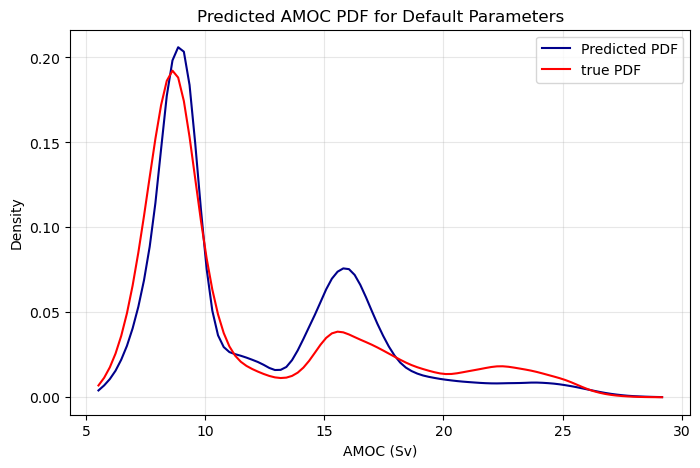

In [10]:
# ----------------------------
# 1. Define default parameter vector for GP inputs
# ----------------------------
X_new = np.array([[
    1e-05,      # diff_dia_min
    3.0,        # drag_topo_fac
    0.001,      # slope_max
    1500,       # diff_iso
    1500,       # diff_gm
    0.00015     # diff_dia_max
]])
print("X_new shape:", X_new.shape)

# ----------------------------
# 2. Predict PDFs and summary stats using fitted GP emulator
# ----------------------------
pdf_pred, Y_pred, pdf_std, Y_std = gp_emul.predict(X_new)

# ----------------------------
# 3. Extract scalar stats
# ----------------------------
avg_stadial_duration, avg_waiting_time, amplitude = Y_pred[0]
print(f"Predicted avg stadial duration: {avg_stadial_duration:.2f}")
print(f"Predicted avg waiting time: {avg_waiting_time:.2f}")
print(f"Predicted amplitude: {amplitude:.4f}")

# ----------------------------
# 4. Plot predicted PDF with uncertainty
# ----------------------------
x_grid = ensemble_stats[0]['x_grid']  # use the same grid as PDFs

plt.figure(figsize=(8,5))
plt.plot(x_grid, pdf_pred[0], color='darkblue', label='Predicted PDF')
plt.plot(x_grid, default_stats['pdf'], color='red', label='true PDF')

plt.xlabel('AMOC (Sv)')
plt.ylabel('Density')
plt.title('Predicted AMOC PDF for Default Parameters')
plt.legend()
plt.grid(alpha=0.3)
plt.show()

In [11]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

X_train, X_test, pdf_train, pdf_test, Y_train, Y_test = train_test_split(
    X, pdf_matrix, avg_stats, test_size=0.2, random_state=42
)
print("Train size:", X_train.shape[0], "Test size:", X_test.shape[0])


Train size: 79 Test size: 20


In [12]:
kernel = 1 * Matern(length_scale=1.0, nu=1.5)
gp_emul = GPEmulatorPDF(pdf_pca_components=6, kernel=kernel)
gp_emul.fit(X_train, Y_train, pdf_train)
print("GP emulator fitted on training set.")


GP emulator fitted on training set.


In [13]:
pdf_pred, Y_pred, pdf_std, Y_std = gp_emul.predict(X_test, return_std=True)


In [14]:
pdf_rmse = np.sqrt(mean_squared_error(pdf_test, pdf_pred))
print(f"PDF reconstruction RMSE: {pdf_rmse:.4f}")
for i, name in enumerate(['avg_stadial_duration', 'avg_waiting_time', 'amplitude']):
    rmse = np.sqrt(mean_squared_error(Y_test[:, i], Y_pred[:, i]))
    print(f"{name} RMSE: {rmse:.4f}")


PDF reconstruction RMSE: 0.0353
avg_stadial_duration RMSE: 1797.5900
avg_waiting_time RMSE: 2956.9033
amplitude RMSE: 3.7022


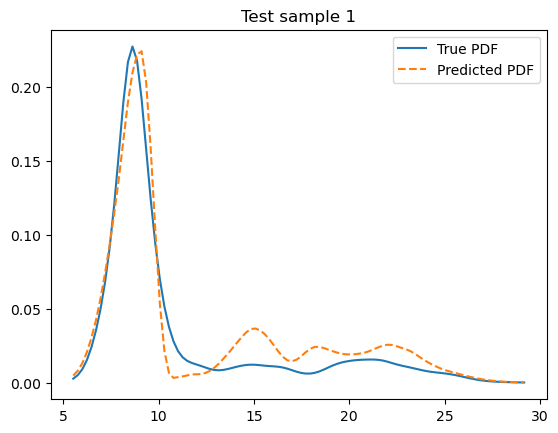

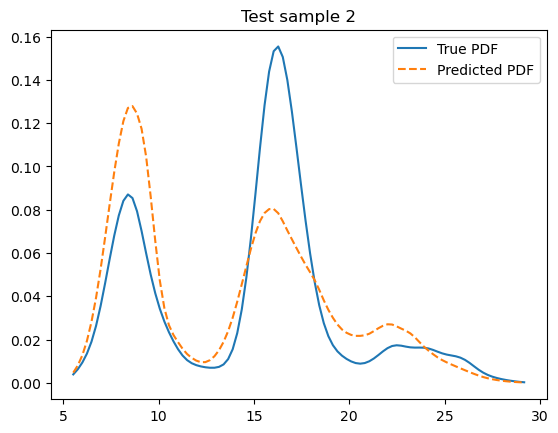

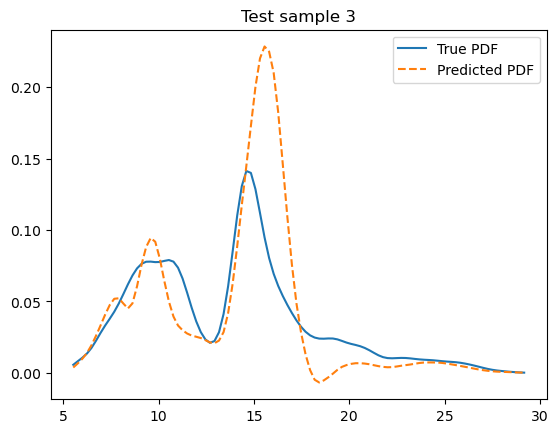

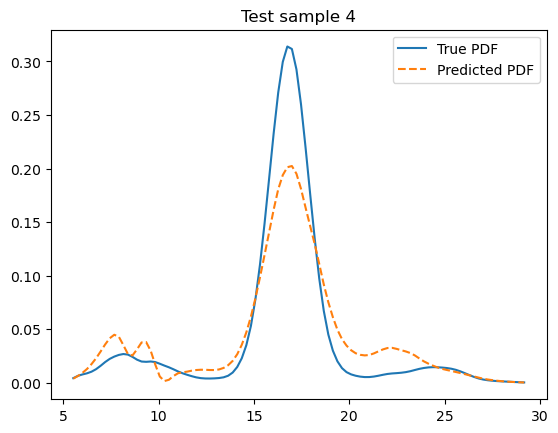

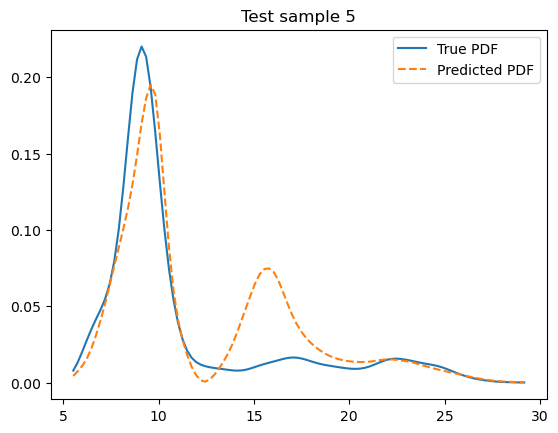

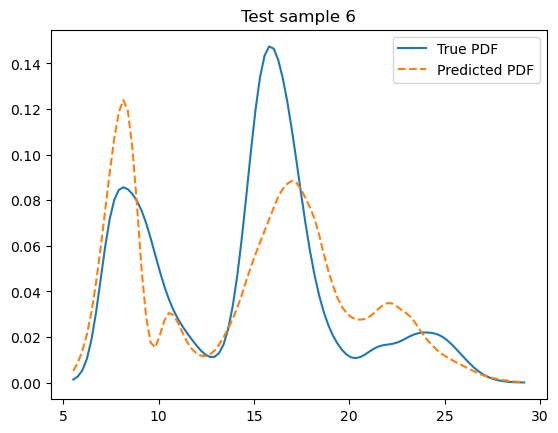

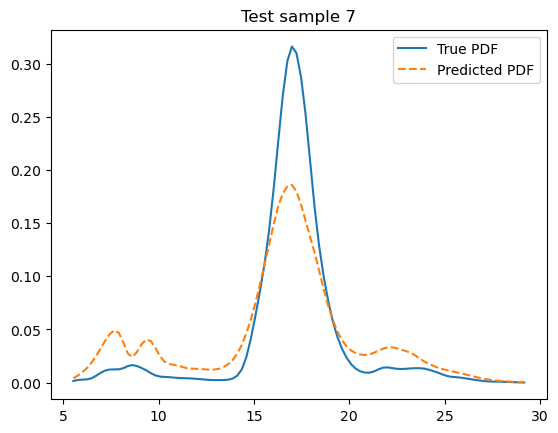

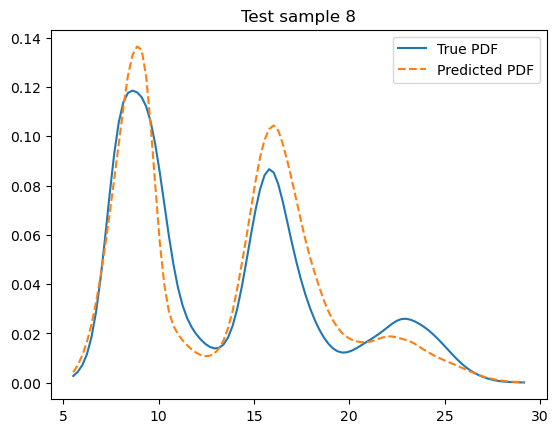

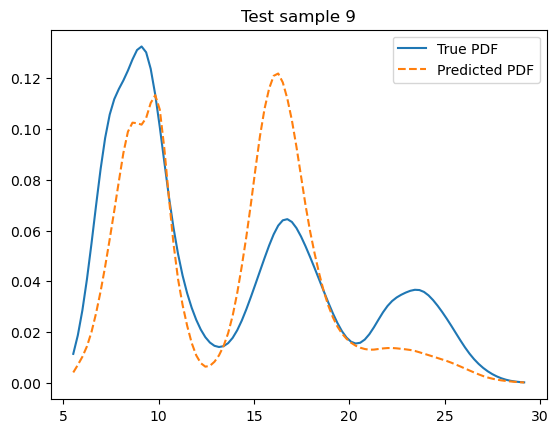

In [15]:
import matplotlib.pyplot as plt

for i in range(1,10):  # plot first 3 test examples
    plt.figure()
    plt.plot(x_grid, pdf_test[i], label='True PDF')
    plt.plot(x_grid, pdf_pred[i], label='Predicted PDF', linestyle='--')
    plt.title(f'Test sample {i}')
    plt.legend()
    plt.show()


In [16]:
def crossvalidation(X, Y, pdfs, emulator_class, emulator_params=None, cv=5,
                   output_names=['avg_stadial_duration', 'avg_waiting_time', 'amplitude']):
    from sklearn.model_selection import KFold
    from sklearn.metrics import mean_squared_error
    
    if emulator_params is None:
        emulator_params = {}
    
    kf = KFold(n_splits=cv, shuffle=True, random_state=42)
    
    pdf_rmses = []
    pdf_sup_diffs = []  # New: supremum differences
    individual_rmses = {name: [] for name in output_names}
    
    for train_idx, test_idx in kf.split(X):
        # Split data
        X_train, X_test = X[train_idx], X[test_idx]
        Y_train, Y_test = Y[train_idx], Y[test_idx]  
        pdfs_train, pdfs_test = pdfs[train_idx], pdfs[test_idx]
        
        # Fit and predict
        emulator = emulator_class(**emulator_params)
        emulator.fit(X_train, Y_train, pdfs_train)
        pdf_pred, Y_pred = emulator.predict(X_test, return_std=False)
        
        # PDF metrics
        pdf_rmse = np.sqrt(mean_squared_error(pdfs_test.flatten(), pdf_pred.flatten()))
        pdf_rmses.append(pdf_rmse)
        
        # PDF supremum difference (max pointwise error across all test PDFs)
        pdf_pointwise_errors = np.abs(pdfs_test - pdf_pred)  # shape: (n_test, n_grid_points)
        pdf_sup_diff = np.max(pdf_pointwise_errors)  # maximum error over all points and all test samples
        pdf_sup_diffs.append(pdf_sup_diff)
        
        # Individual summary statistics RMSEs
        for i, name in enumerate(output_names):
            if i < Y_test.shape[1]:
                rmse = np.sqrt(mean_squared_error(Y_test[:, i], Y_pred[:, i]))
                individual_rmses[name].append(rmse)
    
    # Prepare results
    results = {
        'pdf': {
            'rmse_mean': np.mean(pdf_rmses),
            'rmse_std': np.std(pdf_rmses),
            'rmse_scores': pdf_rmses,
            'sup_diff_mean': np.mean(pdf_sup_diffs),
            'sup_diff_std': np.std(pdf_sup_diffs),
            'sup_diff_scores': pdf_sup_diffs
        }
    }
    
    for name in output_names:
        if len(individual_rmses[name]) > 0:
            results[name] = {
                'mean': np.mean(individual_rmses[name]),
                'std': np.std(individual_rmses[name]),
                'scores': individual_rmses[name]
            }
    
    return results

In [17]:
from sklearn.gaussian_process.kernels import RBF, Matern, WhiteKernel, ConstantKernel

kernel = (
    ConstantKernel(1.0, constant_value_bounds=(0.01, 100.0)) * 
    (RBF(length_scale=[1.0]*6, length_scale_bounds=(0.1, 10.0)) + 
     Matern(length_scale=[1.0]*6, length_scale_bounds=(0.1, 10.0), nu=2.5)) 
    +WhiteKernel(noise_level=1e-6, noise_level_bounds=(1e-10, 1e-2))
)
kernel_matern = 1 * Matern(length_scale=1.0, nu=1.5)

emulator_params = {
    'pdf_pca_components': 5,
    'kernel': kernel_matern
    #'kernel': 1 * Matern(length_scale=1.0, nu=1.5)
}

cv_results = crossvalidation(X, avg_stats, pdf_matrix, GPEmulatorPDF, 
                           emulator_params=emulator_params, 
                           cv=5,
                           output_names=['avg_stadial_duration', 'avg_waiting_time', 'amplitude'])

# Print PDF results with both metrics
print(f"PDF RMSE: {cv_results['pdf']['rmse_mean']:.4f}")
print(f"PDF Sup Diff: {cv_results['pdf']['sup_diff_mean']:.4f}")

# Other results
print(f"Stadial duration RMSE: {cv_results['avg_stadial_duration']['mean']:.4f} ± {cv_results['avg_stadial_duration']['std']:.4f}")
print(f"Waiting time RMSE: {cv_results['avg_waiting_time']['mean']:.4f} ± {cv_results['avg_waiting_time']['std']:.4f}")
print(f"Amplitude RMSE: {cv_results['amplitude']['mean']:.4f} ± {cv_results['amplitude']['std']:.4f}")

PDF RMSE: 0.0438
PDF Sup Diff: 0.5089
Stadial duration RMSE: 2961.6792 ± 1716.6687
Waiting time RMSE: 6563.8360 ± 4644.7683
Amplitude RMSE: 2.5384 ± 0.8802


## Simpler summary statistics

In [18]:
import numpy as np

def compute_simple_summary_stats(amoc_data, time_data=None, 
                                remove_spinup=False, spinup_fraction=0.1, n_bins=10):
    """
    Compute simple summary statistics for AMOC time series.
    
    Parameters:
    -----------
    amoc_data : array-like
        AMOC strength time series
    time_data : array-like, optional
        Time values (if None, assumes uniform spacing)
    remove_spinup : bool
        Whether to remove initial spinup period
    spinup_fraction : float
        Fraction of data to remove as spinup (default 0.1 = 10%)
    
    Returns:
    --------
    dict : Summary statistics
    """
    
    amoc_data = np.asarray(amoc_data)
    
    # Remove spinup if requested
    if remove_spinup:
        start_idx = int(len(amoc_data) * spinup_fraction)
        amoc_data = amoc_data[start_idx:]
    
    # Define fixed bins for consistency across all simulations
    bins = np.linspace(0, 35, n_bins+1)  # 10 bins: [0-3], [3-6], ..., [27-30]
    
    # Calculate bin frequencies for ML emulator
    bin_counts, _ = np.histogram(amoc_data, bins=bins)
    bin_frequencies = bin_counts / len(amoc_data)  # Normalize to [0,1]
    
    # Simplified statistics
    stats = {
        'mean': np.mean(amoc_data),
        'std': np.std(amoc_data),
        'q25': np.percentile(amoc_data, 25),
        'q75': np.percentile(amoc_data, 75),
        'bin_frequencies': bin_frequencies,
    }
    
    return stats

# Helper function to get bins for plotting
def get_amoc_bins(n_bins):
    """Return the standard AMOC bins used across all functions."""
    return np.linspace(0, 35, n_bins+1)

In [19]:
# Default run
default_file = "../default_long_run/ocn_ts.nc"
ds_default = xr.open_dataset(default_file)
amoc_default = ds_default.amoc26N.values
time_default = ds_default.time.values
ds_default.close()

# Compute default summary statistics
default_stats = compute_simple_summary_stats(amoc_default, time_default)
print(f"Default stats computed: {list(default_stats.keys())}")

print(f"Number of ensemble files: {len(model_files)}")

# Ensemble runs
ensemble_stats = []
for i, file in enumerate(model_files):
    ds = xr.open_dataset(file)
    amoc = ds.amoc26N.values
    time = ds.time.values
    ds.close()
    
    stats = compute_simple_summary_stats(amoc, time)
    ensemble_stats.append(stats)

print(f"Total ensemble stats computed: {len(ensemble_stats)}")
print(f"Each run has {len(ensemble_stats[0])} summary statistics")

Default stats computed: ['mean', 'std', 'q25', 'q75', 'bin_frequencies']
Number of ensemble files: 99
Total ensemble stats computed: 99
Each run has 5 summary statistics


In [20]:
def plot_amoc_ensemble_simple(ensemble_stats, model_files, amoc_default, default_stats, 
                             n_runs=None, figsize_per_run=3, n_bins=10):
    """
    Plot AMOC time series and histograms for ensemble runs.
    
    Parameters:
    -----------
    ensemble_stats : list
        List of stats dictionaries from compute_simple_summary_stats
    model_files : list
        List of file paths for ensemble runs
    amoc_default : array-like
        Default/reference AMOC time series
    default_stats : dict
        Stats dictionary for default run
    n_runs : int, optional
        Number of runs to plot (if None, plots all)
    figsize_per_run : float
        Figure height per run in inches
    """
    
    if n_runs is None:
        n_runs = len(ensemble_stats)
    
    fig, axes = plt.subplots(n_runs, 2, figsize=(12, figsize_per_run * n_runs), 
                            gridspec_kw={'width_ratios': [3, 2]})
    
    # Handle single run case
    if n_runs == 1:
        axes = [axes]
    
    for i, (stats, file) in enumerate(zip(ensemble_stats[:n_runs], model_files[:n_runs])):
        ds = xr.open_dataset(file)
        amoc = ds.amoc26N.values
        ds.close()
        
        # ----------------------------
        # 1. Time series plot
        # ----------------------------
        axes[i][0].plot(amoc, color='darkblue', alpha=0.8, label='Ensemble')
        axes[i][0].plot(amoc_default, color='lightcoral', alpha=0.8, label='Default')
        
        # Add horizontal lines for key statistics
        axes[i][0].axhline(stats['mean'], color='darkblue', linestyle='-', alpha=0.3, label='Mean (Ens)')
        axes[i][0].axhline(default_stats['mean'], color='lightcoral', linestyle='-', alpha=0.3, label='Mean (Def)')
        axes[i][0].axhline(stats['q25'], color='darkblue', linestyle='--', alpha=0.3)
        axes[i][0].axhline(stats['q75'], color='darkblue', linestyle='--', alpha=0.3)
        
        axes[i][0].set_ylabel('AMOC (Sv)')
        axes[i][0].set_xlabel('Time')
        axes[i][0].set_title(f'AMOC Time Series - Run {i+1}')
        axes[i][0].legend()
        axes[i][0].grid(alpha=0.3)
        
        # Add summary stats text box
        stats_text = (
            f"Mean: {stats['mean']:.1f} Sv (Def: {default_stats['mean']:.1f})\n"
            f"Std: {stats['std']:.1f} Sv (Def: {default_stats['std']:.1f})\n"
            f"Q25-Q75: {stats['q25']:.1f}-{stats['q75']:.1f} Sv\n"
        )
        
        axes[i][0].text(
            0.98, 0.02, stats_text,
            transform=axes[i][0].transAxes,
            fontsize=8, verticalalignment='bottom', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.8)
        )
        
        # ----------------------------
        # 2. Histogram plot (bins defined in plotting function)
        # ----------------------------
        # Define bins in plotting function for flexibility
        bins = get_amoc_bins(n_bins)
        
        # Plot histograms - matplotlib calculates frequencies automatically
        axes[i][1].hist(amoc, bins=bins, alpha=0.7, color='darkblue', 
                       label='Ensemble', density=True, edgecolor='black')
        axes[i][1].hist(amoc_default, bins=bins, alpha=0.5, color='lightcoral', 
                       label='Default', density=True, edgecolor='black')
        
        # Add vertical lines for key statistics
        axes[i][1].axvline(stats['mean'], color='darkblue', linestyle='-', alpha=0.8, label='Mean (Ens)')
        axes[i][1].axvline(default_stats['mean'], color='lightcoral', linestyle='-', alpha=0.8, label='Mean (Def)')
        axes[i][1].axvline(stats['q25'], color='darkblue', linestyle='--', alpha=0.7, label='Q25/Q75 (Ens)')
        axes[i][1].axvline(stats['q75'], color='darkblue', linestyle='--', alpha=0.7)
        
        axes[i][1].set_xlabel('AMOC (Sv)')
        axes[i][1].set_ylabel('Density')
        axes[i][1].set_title(f'AMOC Distribution - Run {i+1}')
        axes[i][1].legend()
        axes[i][1].grid(alpha=0.3)
        axes[i][1].set_xlim(0, 35)
    
    plt.tight_layout()
    plt.show()

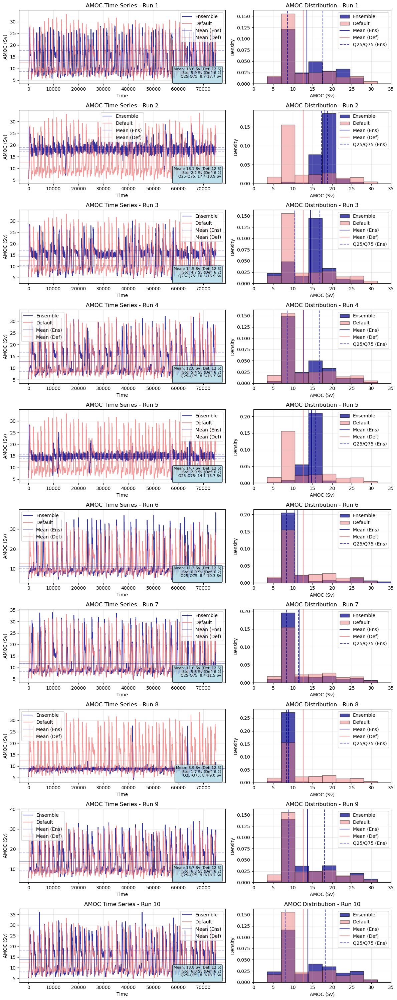

In [21]:
plot_amoc_ensemble_simple(ensemble_stats, model_files, amoc_default, default_stats, 
                             n_runs=10, figsize_per_run=3)

In [22]:
class GPEmulatorBins:
    def __init__(self, kernel=None, scaler_X=None, scaler_y=None):
        """
        GP emulator that predicts bin frequencies and other summary statistics.
        
        Parameters
        ----------
        kernel : GP kernel
            Kernel for the GP. If None, uses RBF + WhiteKernel
        scaler_X : scaler for input features
            If None, uses StandardScaler
        scaler_y : scaler for output features  
            If None, uses StandardScaler
        """
        self.kernel = kernel if kernel is not None else RBF(1.0) + WhiteKernel(1e-6)
        self.scaler_X = scaler_X if scaler_X is not None else StandardScaler()
        self.scaler_y = scaler_y if scaler_y is not None else StandardScaler()
        self.gp_model = None
        self.is_fitted = False
        self.n_bins = None
        self.n_other_stats = None
        
    def fit(self, X, Y, bin_frequencies):
        """
        Fit the GP emulator.
        
        Parameters
        ----------
        X : array-like, shape (n_samples, n_parameters)
            Input parameters
        Y : array-like, shape (n_samples, n_other_summary_stats)
            Other summary statistics (mean, std, q25, q75)
        bin_frequencies : array-like, shape (n_samples, n_bins)
            Bin frequencies for each sample
        """
        # Store dimensions
        self.n_bins = bin_frequencies.shape[1]
        self.n_other_stats = Y.shape[1]
        
        # Combine bin frequencies and other summary stats
        Y_full = np.hstack([bin_frequencies, Y])
        
        # Scale inputs and outputs
        X_scaled = self.scaler_X.fit_transform(X)
        Y_scaled = self.scaler_y.fit_transform(Y_full)
        
        # Fit single multi-output GP (captures correlations between outputs)
        self.gp_model = GaussianProcessRegressor(
            kernel=self.kernel, 
            normalize_y=True,
            n_restarts_optimizer=3
        )
        self.gp_model.fit(X_scaled, Y_scaled)
        self.is_fitted = True
        
    def predict(self, X_new, return_std=False):
        """
        Predict bin frequencies and other summary stats for new inputs.
        
        Parameters
        ----------
        X_new : array-like, shape (n_samples, n_parameters)
            New input parameters
        return_std : bool
            Whether to return uncertainties
        
        Returns
        -------
        bin_frequencies_pred : array, shape (n_samples, n_bins)
            Predicted bin frequencies
        Y_pred : array, shape (n_samples, n_other_summary_stats)
            Predicted other summary statistics
        bin_frequencies_std : array, optional, shape (n_samples, n_bins)
            Uncertainty in bin frequencies
        Y_std : array, optional, shape (n_samples, n_other_summary_stats)
            Uncertainty in other summary statistics
        """
        if not self.is_fitted:
            raise RuntimeError("GPEmulatorBins must be fitted first.")
        
        X_scaled = self.scaler_X.transform(X_new)
        
        # Predict with GP
        if return_std:
            mean_scaled, std_scaled = self.gp_model.predict(X_scaled, return_std=True)
        else:
            mean_scaled = self.gp_model.predict(X_scaled)
            std_scaled = None
        
        # Inverse scaling
        mean_full = self.scaler_y.inverse_transform(mean_scaled)
        
        if return_std and std_scaled is not None:
            std_full = std_scaled * self.scaler_y.scale_
        else:
            std_full = None
        
        # Split bin frequencies and other summary stats
        bin_frequencies_pred = mean_full[:, :self.n_bins]
        Y_pred = mean_full[:, self.n_bins:]
        
        # Ensure bin frequencies are non-negative and sum to 1
        bin_frequencies_pred = self._normalize_bin_frequencies(bin_frequencies_pred)
        
        if return_std and std_full is not None:
            bin_frequencies_std = std_full[:, :self.n_bins]
            Y_std = std_full[:, self.n_bins:]
            
            return bin_frequencies_pred, Y_pred, bin_frequencies_std, Y_std
        else:
            return bin_frequencies_pred, Y_pred
    
    def _normalize_bin_frequencies(self, bin_frequencies):
        """
        Ensure bin frequencies are non-negative and sum to 1.
        """
        # Clip negative values to 0
        bin_frequencies = np.clip(bin_frequencies, 0, None)
        
        # Normalize each row to sum to 1
        row_sums = bin_frequencies.sum(axis=1, keepdims=True)
        # Avoid division by zero
        row_sums = np.where(row_sums == 0, 1, row_sums)
        bin_frequencies = bin_frequencies / row_sums
        
        return bin_frequencies
    
    def score(self, X_test, Y_test, bin_frequencies_test):
        """
        Compute R² score for the model predictions.
        
        Returns
        -------
        scores : dict
            R² scores for bin frequencies and other statistics
        """
        if not self.is_fitted:
            raise RuntimeError("GPEmulatorBins must be fitted first.")
        
        bin_frequencies_pred, Y_pred = self.predict(X_test, return_std=False)
        
        from sklearn.metrics import r2_score
        
        scores = {
            'bin_frequencies_r2': r2_score(bin_frequencies_test, bin_frequencies_pred),
            'other_stats_r2': r2_score(Y_test, Y_pred),
            'overall_r2': r2_score(
                np.hstack([bin_frequencies_test, Y_test]), 
                np.hstack([bin_frequencies_pred, Y_pred])
            )
        }
        
        return scores

Training on 99 runs with 6 parameters
Each distribution has 10 bins
Emulator fitted!
Predicted mean: 12.4 Sv (true: 12.6)
Predicted std:  5.9 Sv (true: 6.2)


/home/karinako/miniconda3/envs/emulator/lib/python3.11/site-packages/sklearn/gaussian_process/kernels.py:440: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


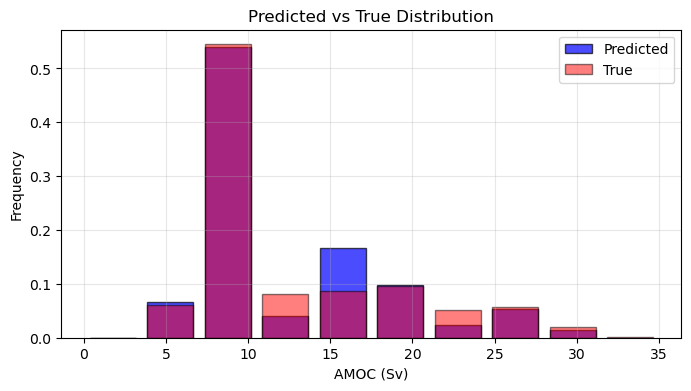

In [23]:
# ----------------------------
# 1. Prepare data
# ----------------------------
param_cols = ['ocn.diff_dia_min', 'ocn.drag_topo_fac', 'ocn.slope_max',
              'ocn.diff_iso', 'ocn.diff_gm', 'ocn.diff_dia_max']
X = params[param_cols].values
bin_frequencies = np.array([s['bin_frequencies'] for s in ensemble_stats])
other_stats = np.array([[s['mean'], s['std'], s['q25'], s['q75']] 
                       for s in ensemble_stats])

print(f"Training on {X.shape[0]} runs with {X.shape[1]} parameters")
print(f"Each distribution has {bin_frequencies.shape[1]} bins")

# ----------------------------
# 2. Fit emulator
# ----------------------------
gp_emul = GPEmulatorBins()
gp_emul.fit(X, other_stats, bin_frequencies)
print("Emulator fitted!")

# ----------------------------
# 3. Make prediction for default parameters
# ----------------------------
X_default = np.array([[1e-05, 3.0, 0.001, 1500, 1500, 0.00015]])
bin_pred, stats_pred = gp_emul.predict(X_default, return_std=False)

print(f"Predicted mean: {stats_pred[0,0]:.1f} Sv (true: {default_stats['mean']:.1f})")
print(f"Predicted std:  {stats_pred[0,1]:.1f} Sv (true: {default_stats['std']:.1f})")

# ----------------------------
# 4. Histogram plot
# ----------------------------
bins = get_amoc_bins(10)
bin_centers = (bins[:-1] + bins[1:]) / 2
bin_width = bins[1] - bins[0]

plt.figure(figsize=(8, 4))
plt.bar(bin_centers, bin_pred[0], width=bin_width*0.8, alpha=0.7, color='blue', 
        label='Predicted', edgecolor='black')
plt.bar(bin_centers, default_stats['bin_frequencies'], width=bin_width*0.8, alpha=0.5, 
        color='red', label='True', edgecolor='black')
plt.xlabel('AMOC (Sv)')
plt.ylabel('Frequency')
plt.title('Predicted vs True Distribution')
plt.legend()
plt.grid(alpha=0.3)
plt.show()


Train size: 79, Test size: 20
GP emulator fitted on training set.
Bin frequencies RMSE: 0.0535
mean RMSE: 0.4503
std RMSE: 0.9415
q25 RMSE: 1.6053
q75 RMSE: 1.7155


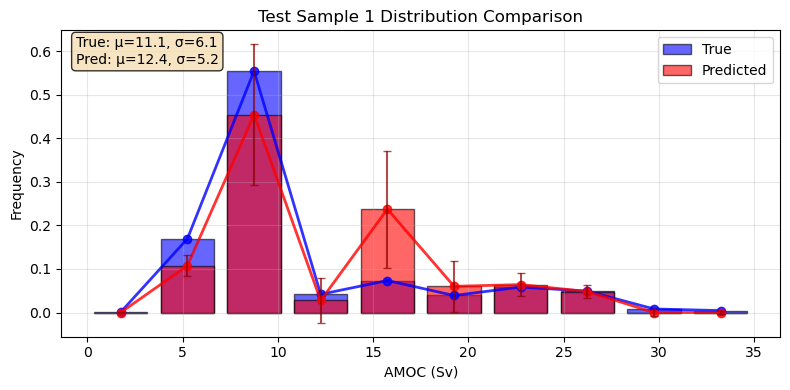

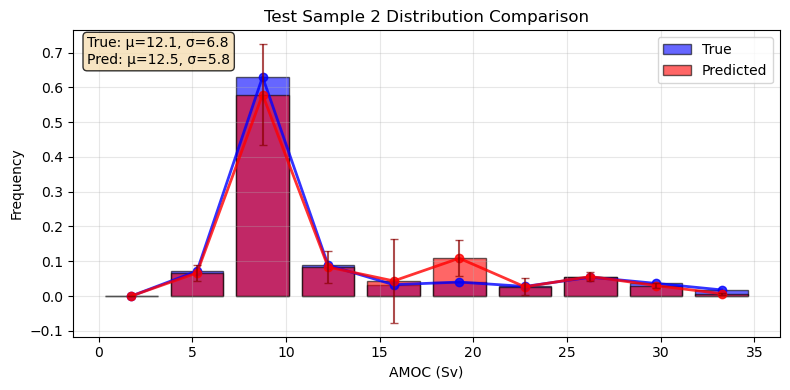

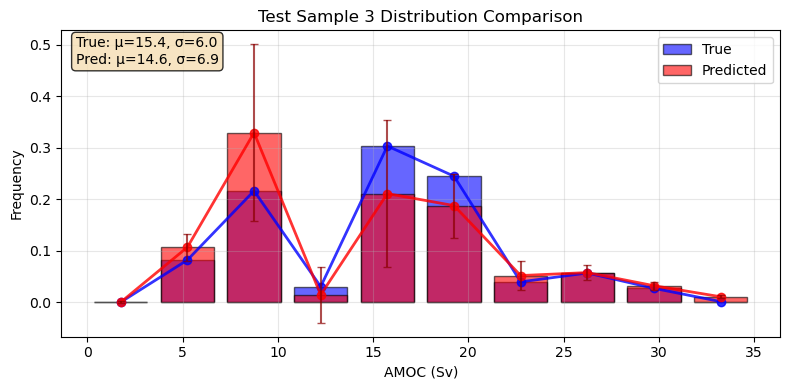

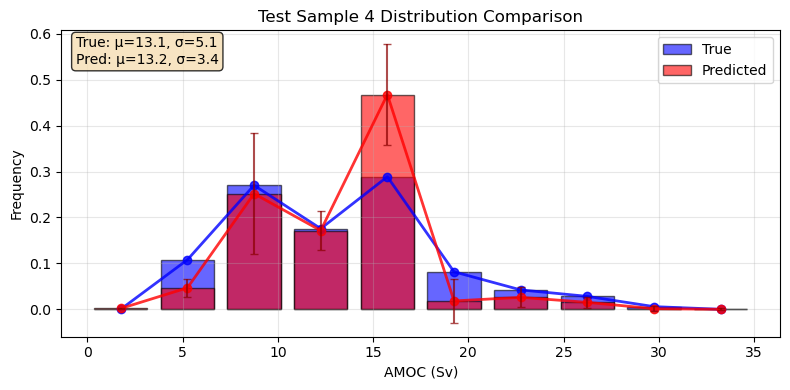

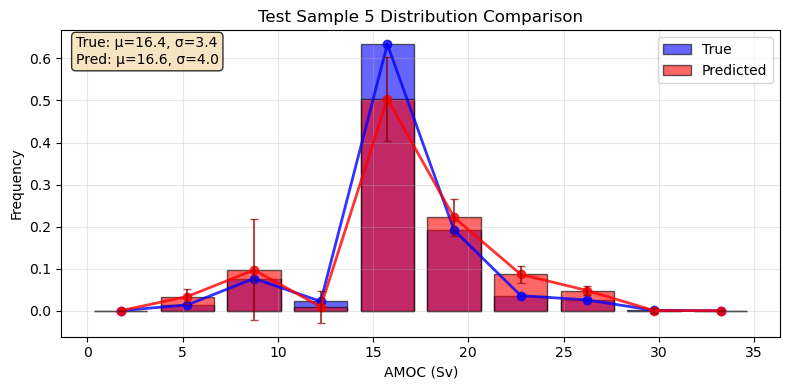

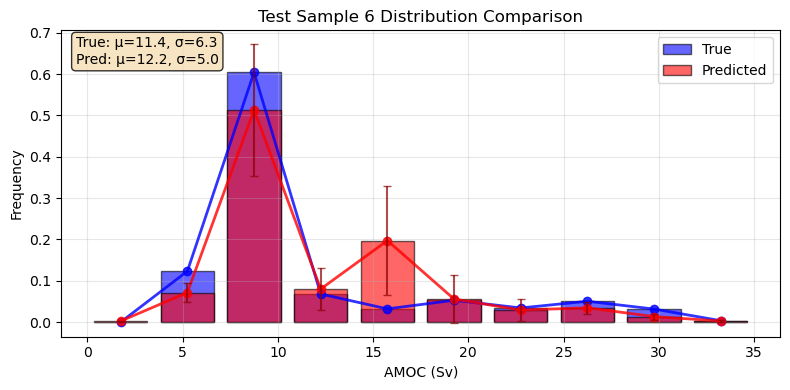

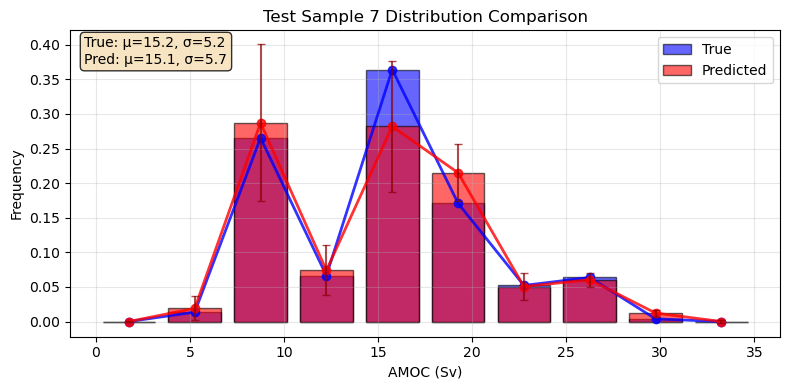

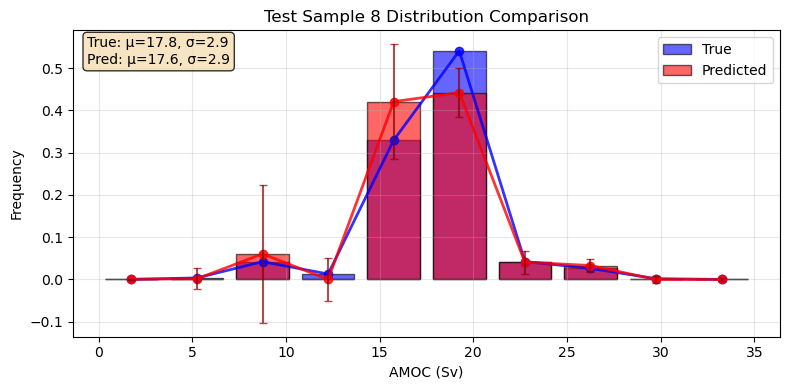

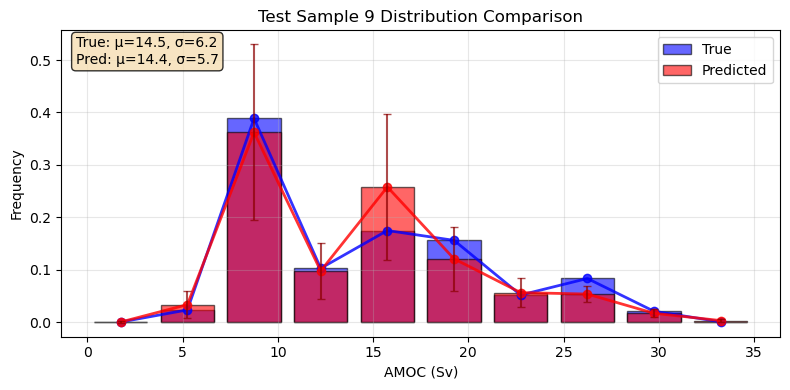

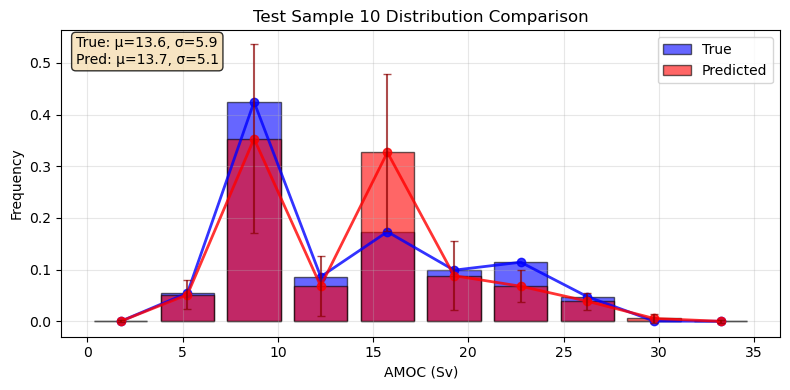


TEST PERFORMANCE
Bin frequencies R²: 0.890
Bin frequencies RMSE: 0.0535

Individual Statistics:
  mean: R² = 0.952, RMSE = 0.4503
  std: R² = 0.571, RMSE = 0.9415
  q25: R² = 0.668, RMSE = 1.6053
  q75: R² = 0.667, RMSE = 1.7155


In [24]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.gaussian_process.kernels import Matern
import matplotlib.pyplot as plt
import numpy as np

# ----------------------------
# 1. Prepare data and split
# ----------------------------
X_train, X_test, bin_train, bin_test, Y_train, Y_test = train_test_split(
    X, bin_frequencies, other_stats, test_size=0.2, random_state=42
)
print(f"Train size: {X_train.shape[0]}, Test size: {X_test.shape[0]}")

# ----------------------------
# 2. Fit emulator on training data
# ----------------------------
kernel = 1 * Matern(length_scale=1.0, nu=1.5)
gp_emul = GPEmulatorBins(kernel=kernel)
gp_emul.fit(X_train, Y_train, bin_train)
print("GP emulator fitted on training set.")

# ----------------------------
# 3. Predict on test set
# ----------------------------
bin_pred, Y_pred, bin_std, Y_std = gp_emul.predict(X_test, return_std=True)

# ----------------------------
# 4. Calculate RMSE metrics
# ----------------------------
bin_rmse = np.sqrt(mean_squared_error(bin_test, bin_pred))
print(f"Bin frequencies RMSE: {bin_rmse:.4f}")

stat_names = ['mean', 'std', 'q25', 'q75']
for i, name in enumerate(stat_names):
    rmse = np.sqrt(mean_squared_error(Y_test[:, i], Y_pred[:, i]))
    print(f"{name} RMSE: {rmse:.4f}")

# ----------------------------
# 5. Plot test examples (limit to first 3) - MODIFIED SECTION
# ----------------------------
bins = get_amoc_bins(10)
bin_centers = (bins[:-1] + bins[1:]) / 2
bin_width = bins[1] - bins[0]

# Plot first 3 test examples
for i in range(min(10, len(bin_test))):
    plt.figure(figsize=(8, 4))
    
    # Plot overlapping bars at same x-coordinates
    plt.bar(bin_centers, bin_test[i], width=bin_width*0.8, 
            alpha=0.6, color='blue', label='True', edgecolor='black')
    plt.bar(bin_centers, bin_pred[i], width=bin_width*0.8, 
            alpha=0.6, color='red', label='Predicted', edgecolor='black')
    
    # Add line plots connecting the top centers of each bar type
    plt.plot(bin_centers, bin_test[i], 'o-', color='blue', 
             linewidth=2, markersize=6, alpha=0.8)
    plt.plot(bin_centers, bin_pred[i], 'o-', color='red', 
             linewidth=2, markersize=6, alpha=0.8)
    
    # Add error bars for uncertainty on predicted values
    plt.errorbar(bin_centers, bin_pred[i], yerr=bin_std[i], 
                fmt='none', color='darkred', capsize=3, alpha=0.7, linewidth=1.5)
    
    plt.xlabel('AMOC (Sv)')
    plt.ylabel('Frequency')
    plt.title(f'Test Sample {i+1} Distribution Comparison')
    plt.legend()
    plt.grid(alpha=0.3)
    
    # Add statistics text
    stats_text = (f"True: μ={Y_test[i,0]:.1f}, σ={Y_test[i,1]:.1f}\n"
                 f"Pred: μ={Y_pred[i,0]:.1f}, σ={Y_pred[i,1]:.1f}")
    plt.text(0.02, 0.98, stats_text, transform=plt.gca().transAxes, 
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))
    
    plt.tight_layout()
    plt.show()

# ----------------------------
# 6. Performance summary with separate R² scores
# ----------------------------
print("\n" + "="*40)
print("TEST PERFORMANCE")
print("="*40)

# Bin frequencies
bin_r2 = r2_score(bin_test.flatten(), bin_pred.flatten())
print(f"Bin frequencies R²: {bin_r2:.3f}")
print(f"Bin frequencies RMSE: {bin_rmse:.4f}")

# Individual statistics R² and RMSE
print("\nIndividual Statistics:")
for i, name in enumerate(stat_names):
    r2 = r2_score(Y_test[:, i], Y_pred[:, i])
    rmse = np.sqrt(mean_squared_error(Y_test[:, i], Y_pred[:, i]))
    print(f"  {name}: R² = {r2:.3f}, RMSE = {rmse:.4f}")

In [25]:
def crossvalidation_bins(X, Y, bin_frequencies, emulator_class, emulator_params=None, cv=5,
                        output_names=['mean', 'std', 'q25', 'q75']):
    """
    Cross-validation for bin-based emulator with Matern kernels.
    
    Parameters
    ----------
    X : array-like, shape (n_samples, n_parameters)
        Input parameters
    Y : array-like, shape (n_samples, n_stats)
        Summary statistics (mean, std, q25, q75)
    bin_frequencies : array-like, shape (n_samples, n_bins)
        Bin frequencies for each sample
    emulator_class : class
        Emulator class (e.g., GPEmulatorBins)
    emulator_params : dict, optional
        Parameters for emulator initialization
    cv : int
        Number of cross-validation folds
    output_names : list
        Names of output statistics
    
    Returns
    -------
    results : dict
        Cross-validation results with mean scores
    """
    from sklearn.model_selection import KFold
    from sklearn.metrics import mean_squared_error
    import numpy as np
    
    if emulator_params is None:
        emulator_params = {}
    
    kf = KFold(n_splits=cv, shuffle=True, random_state=42)
    
    bin_rmses = []
    bin_sup_diffs = []  # Maximum error across all bins
    individual_rmses = {name: [] for name in output_names}
    bin_r2_scores = []
    
    for fold, (train_idx, test_idx) in enumerate(kf.split(X)):
        # Split data
        X_train, X_test = X[train_idx], X[test_idx]
        Y_train, Y_test = Y[train_idx], Y[test_idx]  
        bins_train, bins_test = bin_frequencies[train_idx], bin_frequencies[test_idx]
        
        # Fit and predict
        emulator = emulator_class(**emulator_params)
        emulator.fit(X_train, Y_train, bins_train)
        bins_pred, Y_pred = emulator.predict(X_test)
        
        # Bin frequency metrics
        bin_rmse = np.sqrt(mean_squared_error(bins_test.flatten(), bins_pred.flatten()))
        bin_rmses.append(bin_rmse)
        
        # Bin supremum difference (max pointwise error across all test samples)
        bin_pointwise_errors = np.abs(bins_test - bins_pred)  # shape: (n_test, n_bins)
        bin_sup_diff = np.max(bin_pointwise_errors)  # maximum error over all bins and test samples
        bin_sup_diffs.append(bin_sup_diff)
        
        # Overall R² score
        scores = emulator.score(X_test, Y_test, bins_test)
        bin_r2_scores.append(scores['bin_frequencies_r2'])
        
        # Individual summary statistics RMSEs
        for i, name in enumerate(output_names):
            if i < Y_test.shape[1]:
                rmse = np.sqrt(mean_squared_error(Y_test[:, i], Y_pred[:, i]))
                individual_rmses[name].append(rmse)
    
    # Calculate means across all folds
    results = {
        'bins_rmse': np.mean(bin_rmses),
        'bins_max_error': np.mean(bin_sup_diffs),
        'bins_r2': np.mean(bin_r2_scores)
    }
    
    # Add individual statistics means
    for name in output_names:
        if len(individual_rmses[name]) > 0:
            results[f'{name}_rmse'] = np.mean(individual_rmses[name])
    
    return results


# Example usage with Matern ν=1.5
from sklearn.gaussian_process.kernels import Matern
import numpy as np

print("Running cross-validation with Matern ν=1.5 kernel...")
print("="*60)

# Use Matern ν=1.5 kernel
kernel = Matern(length_scale=1.0, nu=1.5)
emulator_params = {'kernel': kernel}

results = crossvalidation_bins(X, other_stats, bin_frequencies, GPEmulatorBins, 
                              emulator_params=emulator_params, cv=5,
                              output_names=['mean', 'std', 'q25', 'q75'])

print(f"Bins RMSE: {results['bins_rmse']:.4f}")
print(f"Bins Max Error (mean of fold maxima): {results['bins_max_error']:.4f}")
#print(f"Bins R²: {results['bins_r2']:.3f}")
print("\nIndividual Statistics RMSE:")
for name in ['mean', 'std', 'q25', 'q75']:
    if f'{name}_rmse' in results:
        print(f"  {name}: {results[f'{name}_rmse']:.4f}")

print(f"\n{'='*60}")

Running cross-validation with Matern ν=1.5 kernel...
Bins RMSE: 0.0572
Bins Max Error (mean of fold maxima): 0.4218

Individual Statistics RMSE:
  mean: 0.6707
  std: 0.9791
  q25: 1.7159
  q75: 1.7771



# ABC parameter estimation with GP emulator

In [42]:
import numpy as np

class ABCBins:
    def __init__(self, emulator, bins_default, stats_default,
                 std_tol=0.5, bin_tol=0.05, prior_sampler=None):
        """
        Approximate Bayesian Computation for GPEmulatorBins.

        Parameters
        ----------
        emulator : GPEmulatorBins (trained)
            Emulator mapping parameters -> (bins, stats).
        bins_obs : array, shape (n_bins,)
            Observed bin frequencies to match.
        stats_obs : array, shape (n_stats,)
            Observed summary stats (mean, std, ...).
        std_tol : float
            Maximum allowed absolute difference in std.
        bin_tol : float
            Maximum allowed absolute difference in any bin.
        prior_sampler : callable
            Function returning a random parameter vector from the prior.
        """
        self.emulator = emulator
        self.bins_default = np.asarray(bins_default).flatten()
        self.stats_default = np.asarray(stats_default).flatten()
        self.std_tol = std_tol
        self.bin_tol = bin_tol
        self.prior_sampler = prior_sampler

    def _distance_checks(self, theta):
        
        theta = np.array(theta).reshape(1, -1)
        pred_bins, pred_stats = self.emulator.predict(theta, return_std=False)
    
        std_diff = np.abs(pred_stats.flatten()[1] - self.stats_default[1])

        bin_max_diff = np.max(np.abs(pred_bins - self.bins_default))
        
        return std_diff, bin_max_diff


    def sample(self, n_samples=1000, max_iter=10000):
        """
        Run ABC rejection sampling.

        Returns
        -------
        accepted : array, shape (n_accepted, n_parameters)
            Accepted parameter sets.
        """
        if self.prior_sampler is None:
            raise ValueError("Please provide a prior_sampler when creating ABCBins.")
        
        accepted = []
        for _ in range(max_iter):
            theta = self.prior_sampler()
            std_diff, bin_max_diff = self._distance_checks(theta)

            if (std_diff < self.std_tol) and (bin_max_diff < self.bin_tol):
                accepted.append(theta)

            if len(accepted) >= n_samples:
                break

        return np.array(accepted)


In [50]:
kernel = 1.0 * Matern(length_scale=1.0, nu=1.5)
gp_emulator = GPEmulatorBins(kernel=kernel)

# Fit on full dataset
gp_emulator.fit(X, other_stats, bin_frequencies)
print("GP Emulator trained on full dataset.")

# Observed summaries from default run
bins_default = default_stats['bin_frequencies']   # shape (n_bins,)

stats_default = np.array([
    default_stats['mean'],
    default_stats['std'],
    default_stats['q25'],
    default_stats['q75']
])


# -----------------------------
# 2. Define prior sampler
# -----------------------------
prior_bounds = {
    "diff_dia_min": (7.5e-6, 1.25e-5),
    "drag_topo_fac": (2.25, 3.75),
    "slope_max": (7.5e-4, 1.25e-3),
    "diff_iso": (1125, 1875),
    "diff_gm": (1125, 1875),
    "diff_dia_max": (1.125e-4, 1.875e-4),
}

def prior_sampler():
    return np.array([
        np.random.uniform(*prior_bounds["diff_dia_min"]),
        np.random.uniform(*prior_bounds["drag_topo_fac"]),
        np.random.uniform(*prior_bounds["slope_max"]),
        np.random.uniform(*prior_bounds["diff_iso"]),
        np.random.uniform(*prior_bounds["diff_gm"]),
        np.random.uniform(*prior_bounds["diff_dia_max"]),
    ])
np.random.seed(42)  # for reproducibility
abc = ABCBins(
    emulator=gp_emulator,
    bins_default=bins_default,
    stats_default=stats_default,
    std_tol=0.2,
    bin_tol=0.015,
    prior_sampler=prior_sampler
)

accepted_params = abc.sample(n_samples=100000, max_iter=100000)
print(f"Accepted {accepted_params.shape[0]} parameter sets")


GP Emulator trained on full dataset.
Accepted 11 parameter sets


In [51]:
print(accepted_params[:10])

[[8.31171171e-06 3.05269407e+00 1.04415215e-03 1.45730003e+03
  1.13402556e+03 1.49375494e-04]
 [1.23674920e-05 3.45002274e+00 1.02739239e-03 1.72803836e+03
  1.35158901e+03 1.31029426e-04]
 [1.11479387e-05 3.19778403e+00 1.06547436e-03 1.66462832e+03
  1.47428213e+03 1.43047848e-04]
 [1.16861824e-05 3.19200911e+00 1.10377501e-03 1.56361417e+03
  1.36415727e+03 1.39697380e-04]
 [8.80781845e-06 2.91244376e+00 1.04055048e-03 1.27256491e+03
  1.31955396e+03 1.60211106e-04]
 [1.04082764e-05 3.18027596e+00 1.04344822e-03 1.63594704e+03
  1.50968569e+03 1.55205957e-04]
 [9.81478985e-06 2.87478448e+00 1.18422756e-03 1.42092726e+03
  1.49547190e+03 1.58449811e-04]
 [1.17491589e-05 3.14117893e+00 1.10322522e-03 1.51160894e+03
  1.43046114e+03 1.45086139e-04]
 [8.66984457e-06 3.40350985e+00 8.28938981e-04 1.63101502e+03
  1.18951540e+03 1.49211927e-04]
 [1.04841320e-05 2.91382812e+00 1.20460024e-03 1.51201455e+03
  1.51224094e+03 1.47871364e-04]]


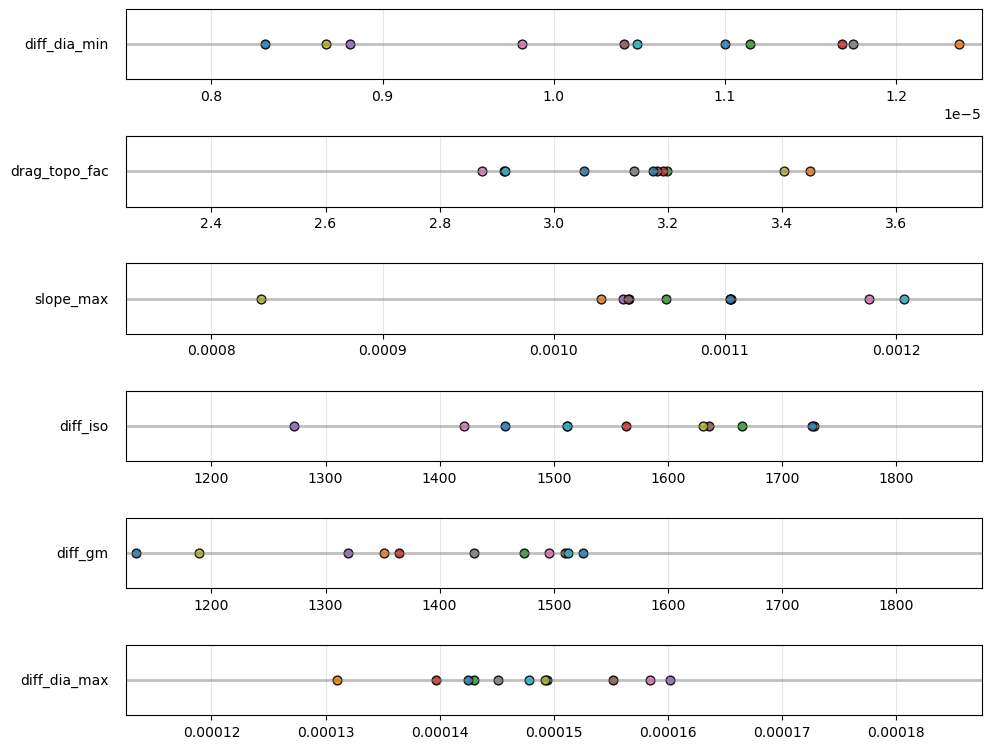

In [52]:
import matplotlib.pyplot as plt
import numpy as np
import itertools

# -------------------------------------------------------
# Example setup (replace with your real arrays)
# -------------------------------------------------------
param_names = ["diff_dia_min", "drag_topo_fac", "slope_max",
               "diff_iso", "diff_gm", "diff_dia_max"]

bounds = np.array([prior_bounds[p] for p in param_names])   # shape (6, 2)
accepted = np.array(accepted_params)                        # (n_sets, 6)
n_params = len(param_names)
n_sets = accepted.shape[0]

# Use matplotlib’s standard color cycle (blue, orange, green, red, …)
default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
color_cycle = list(itertools.islice(itertools.cycle(default_colors), n_sets))

# -------------------------------------------------------
# Plot
# -------------------------------------------------------
fig, axes = plt.subplots(n_params, 1, figsize=(10, 8), sharex=False)

for j, ax in enumerate(axes):
    lb, ub = bounds[j]
    ax.set_xlim(lb, ub)
    ax.set_ylabel(param_names[j], rotation=0, ha='right', va='center')
    ax.yaxis.set_label_coords(-0.02, 0.5)
    ax.set_yticks([])  # no y ticks
    ax.grid(axis='x', alpha=0.3)

    # horizontal line for prior bounds
    ax.hlines(y=0, xmin=lb, xmax=ub, color='gray', lw=2, alpha=0.5)

    # dots for accepted values (same color per combination)
    for k in range(n_sets):
        ax.scatter(accepted[k, j], 0,
                   color=color_cycle[k],
                   s=40, edgecolor='k', alpha=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


# NNs

In [ ]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

class NNEmulatorBins:
    def __init__(self,
                 n_parameters,
                 n_bins,
                 n_other_stats,
                 n_hidden_layers=2,       
                 n_nodes=32,              
                 activation="relu",
                 learning_rate=1e-3,
                 l2_reg=1e-4,             
                 dropout_rate=0.2,        
                 patience=20):
        """
        Keras NN emulator for bin frequencies + other summary stats.

        Parameters
        ----------
        n_parameters : int
            Number of input parameters.
        n_bins : int
            Number of bin frequencies to predict.
        n_other_stats : int
            Number of additional summary statistics.
        n_hidden_layers : int, default=2
            Number of hidden layers (smaller for small data).
        n_nodes : int, default=32
            Nodes per hidden layer.
        activation : str
            'relu' or 'leaky_relu'.
        learning_rate : float
            Learning rate for Adam optimizer.
        l2_reg : float
            L2 weight decay for regularization.
        dropout_rate : float
            Dropout rate between layers.
        patience : int
            Early stopping patience.
        """
        self.n_parameters = n_parameters
        self.n_bins = n_bins
        self.n_other_stats = n_other_stats
        self.output_dim = n_bins + n_other_stats

        self.scaler_X = StandardScaler()
        self.scaler_y = StandardScaler()
        self.is_fitted = False
        self.patience = patience

        self.model = self._build_model(
            n_hidden_layers, n_nodes, activation,
            learning_rate, l2_reg, dropout_rate
        )

    def _build_model(self, n_hidden_layers, n_nodes, activation, learning_rate, l2_reg, dropout_rate):
        inputs = keras.Input(shape=(self.n_parameters,))
        x = inputs

        # Choose activation
        if activation.lower() == "relu":
            act_fn = layers.ReLU()
        elif activation.lower() in ["leakyrelu", "leaky_relu"]:
            act_fn = layers.LeakyReLU(alpha=0.01)
        else:
            raise ValueError("activation must be 'relu' or 'leaky_relu'")

        # Hidden layers with L2 regularization and Dropout
        for _ in range(n_hidden_layers):
            x = layers.Dense(n_nodes,
                             kernel_regularizer=keras.regularizers.l2(l2_reg))(x)
            x = act_fn(x)
            x = layers.Dropout(dropout_rate)(x)

        outputs = layers.Dense(self.output_dim)(x)

        model = keras.Model(inputs, outputs)
        model.compile(
            optimizer=keras.optimizers.Adam(learning_rate),
            loss="mse"
        )
        return model

    def fit(self, X, Y, bin_frequencies,
            epochs=50, batch_size=8, validation_split=0.2, verbose=0):
        """
        Train the model with built-in early stopping.

        Parameters
        ----------
        X : (n_samples, n_parameters)
        Y : (n_samples, n_other_stats)
        bin_frequencies : (n_samples, n_bins)
        """
        Y_full = np.hstack([bin_frequencies, Y])

        # Scale input/output
        X_scaled = self.scaler_X.fit_transform(X)
        Y_scaled = self.scaler_y.fit_transform(Y_full)

        # Early stopping
        es_callback = keras.callbacks.EarlyStopping(
            patience=self.patience,
            restore_best_weights=True
        )

        self.model.fit(
            X_scaled, Y_scaled,
            epochs=epochs,
            batch_size=batch_size,
            validation_split=validation_split,
            callbacks=[es_callback],
            verbose=verbose
        )

        self.is_fitted = True

    def predict(self, X_new):
        if not self.is_fitted:
            raise RuntimeError("Model must be fitted first.")
        X_scaled = self.scaler_X.transform(X_new)
        preds_scaled = self.model.predict(X_scaled, verbose=0)
        preds = self.scaler_y.inverse_transform(preds_scaled)

        # Split predictions
        bin_frequencies_pred = preds[:, :self.n_bins]
        Y_pred = preds[:, self.n_bins:]

        # Normalize bin frequencies
        bin_frequencies_pred = self._normalize_bin_frequencies(bin_frequencies_pred)
        return bin_frequencies_pred, Y_pred

    def _normalize_bin_frequencies(self, bin_frequencies):
        bin_frequencies = np.clip(bin_frequencies, 0, None)
        row_sums = bin_frequencies.sum(axis=1, keepdims=True)
        row_sums = np.where(row_sums == 0, 1, row_sums)
        return bin_frequencies / row_sums

    def score(self, X_test, Y_test, bin_frequencies_test):
        bin_pred, Y_pred = self.predict(X_test)
        return {
            "bin_frequencies_r2": r2_score(bin_frequencies_test, bin_pred),
            "other_stats_r2": r2_score(Y_test, Y_pred),
            "overall_r2": r2_score(
                np.hstack([bin_frequencies_test, Y_test]),
                np.hstack([bin_pred, Y_pred])
            )
        }


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np

# --------------------------------------------------
# 1. Prepare data and split
# --------------------------------------------------
X_train, X_test, bin_train, bin_test, Y_train, Y_test = train_test_split(
    X, bin_frequencies, other_stats, test_size=0.2, random_state=42
)
print(f"Train size: {X_train.shape[0]}, Test size: {X_test.shape[0]}")

# --------------------------------------------------
# 2. Fit Keras NN emulator on training data
# --------------------------------------------------
nn_emul = NNEmulatorBins(
    n_parameters=X.shape[1],
    n_bins=bin_frequencies.shape[1],
    n_other_stats=other_stats.shape[1],
    n_hidden_layers=2,      # small default for ~100 samples
    n_nodes=32,
    activation="relu",
    learning_rate=1e-3,
    l2_reg=1e-4,
    dropout_rate=0.2,
    patience=20
)

nn_emul.fit(X_train, Y_train, bin_train,
            epochs=100, batch_size=8,
            validation_split=0.2, verbose=0)
print("NN emulator fitted on training set.")

# --------------------------------------------------
# 3. Predict on test set
# --------------------------------------------------
bin_pred, Y_pred = nn_emul.predict(X_test)

# --------------------------------------------------
# 4. Calculate RMSE metrics
# --------------------------------------------------
bin_rmse = np.sqrt(mean_squared_error(bin_test, bin_pred))
print(f"Bin frequencies RMSE: {bin_rmse:.4f}")

stat_names = ['mean', 'std', 'q25', 'q75']
for i, name in enumerate(stat_names):
    rmse = np.sqrt(mean_squared_error(Y_test[:, i], Y_pred[:, i]))
    print(f"{name} RMSE: {rmse:.4f}")

# --------------------------------------------------
# 5. Plot test examples (limit to first 10)
# --------------------------------------------------
bins = get_amoc_bins(10)             # same helper function you already have
bin_centers = (bins[:-1] + bins[1:]) / 2
bin_width = bins[1] - bins[0]

for i in range(min(10, len(bin_test))):
    plt.figure(figsize=(8, 4))

    # True vs Predicted bars
    plt.bar(bin_centers, bin_test[i], width=bin_width*0.8,
            alpha=0.6, color='blue', label='True', edgecolor='black')
    plt.bar(bin_centers, bin_pred[i], width=bin_width*0.8,
            alpha=0.6, color='red', label='Predicted', edgecolor='black')

    # Line plots
    plt.plot(bin_centers, bin_test[i], 'o-', color='blue',
             linewidth=2, markersize=6, alpha=0.8)
    plt.plot(bin_centers, bin_pred[i], 'o-', color='red',
             linewidth=2, markersize=6, alpha=0.8)

    plt.xlabel('AMOC (Sv)')
    plt.ylabel('Frequency')
    plt.title(f'Test Sample {i+1} Distribution Comparison')
    plt.legend()
    plt.grid(alpha=0.3)

    # Statistics text (no std bars here since NN does not output uncertainties)
    stats_text = (f"True: μ={Y_test[i,0]:.1f}, σ={Y_test[i,1]:.1f}\n"
                  f"Pred: μ={Y_pred[i,0]:.1f}, σ={Y_pred[i,1]:.1f}")
    plt.text(0.02, 0.98, stats_text, transform=plt.gca().transAxes,
             verticalalignment='top',
             bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

    plt.tight_layout()
    plt.show()

# --------------------------------------------------
# 6. Performance summary with separate R² scores
# --------------------------------------------------
print("\n" + "="*40)
print("TEST PERFORMANCE")
print("="*40)

# Bin frequencies
bin_r2 = r2_score(bin_test.flatten(), bin_pred.flatten())
print(f"Bin frequencies R²: {bin_r2:.3f}")
print(f"Bin frequencies RMSE: {bin_rmse:.4f}")

# Individual statistics R² and RMSE
print("\nIndividual Statistics:")
for i, name in enumerate(stat_names):
    r2 = r2_score(Y_test[:, i], Y_pred[:, i])
    rmse = np.sqrt(mean_squared_error(Y_test[:, i], Y_pred[:, i]))
    print(f"  {name}: R² = {r2:.3f}, RMSE = {rmse:.4f}")


In [ ]:
emulator_params = {
    'n_parameters': X.shape[1],
    'n_bins': bin_frequencies.shape[1],
    'n_other_stats': other_stats.shape[1],
    'n_hidden_layers': 2,
    'n_nodes': 32,
    'activation': 'relu',
    'learning_rate': 1e-3,
    'l2_reg': 1e-4,
    'dropout_rate': 0.2,
    'patience': 20
}

results = crossvalidation_bins(
    X, other_stats, bin_frequencies, 
    NNEmulatorBins, 
    emulator_params=emulator_params, 
    cv=5,
    output_names=['mean', 'std', 'q25', 'q75']
)

print(f"Bins RMSE: {results['bins_rmse']:.4f}")
print(f"Bins Max Error: {results['bins_max_error']:.4f}")
print(f"Bins R²: {results['bins_r2']:.3f}")
